### Cloning Repo and install requirements

In [ ]:
import os
!git clone https://github.com/JiayuanWang-JW/YOLOv8-multi-task
os.chdir('/content/YOLOv8-multi-task')
!pip install --quiet -e .
os.chdir('/content')
!pip install --quiet ultralytics
# !pip uninstall -y albumentations ## Data augmentations did not work with multitask
!rm -r sample_data
os.kill(os.getpid(), 9) # Restart Runtime

Cloning into 'YOLOv8-multi-task'...
remote: Enumerating objects: 1698, done.
remote: Counting objects: 100% (290/290), done.
remote: Compressing objects: 100% (234/234), done.
remote: Total 1698 (delta 105), reused 196 (delta 49), pack-reused 1408
Receiving objects: 100% (1698/1698), 19.55 MiB | 17.61 MiB/s, done.
Resolving deltas: 100% (201/201), done.
Updating files: 100% (1313/1313), done.
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 301.8/301.8 kB 585.3 kB/s eta 0:00:00


$$$$

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### Download Dataset

In [ ]:
!gdown 1iBpVko2sehPeOPhQXWaujOpKFQmNvd_m
!unrar x -y /content/RailSem19.rar RailSem19
!rm /content/RailSem19.rar

### Initialise Model

In [ ]:
import os
import torch
from ultralytics import YOLO
import torch.nn as nn
import ultralytics
import sys

In [ ]:
model = YOLO('/content/drive/MyDrive/Stage 2024/best 3.pt')

$$$$

## Prediction

In [ ]:
import numpy as np
import json
from random import shuffle
import cv2
import os
from tqdm.auto import tqdm
from PIL import Image
import glob

**Warmup Model**

In [ ]:
# Make prediction on random image to prepare Predictor and AutoBackend Model for Inference
res = model.predict(source=np.random.randint(0,256,
                                             size=(720,1280,3),
                                             dtype=np.uint8),
                    imgsz=(640,640),
                    name='Rail',
                    conf=0.2,
                    iou=0.25,
                    speed = True)


0: 384x640 (no detections), 107.4ms


**Helper Functions**

In [ ]:
def files_in_subdirs(start_dir, pattern = ["*.png","*.jpg","*.jpeg"]):
    """
      Return all the files inside a directory
       that has a certain pattern
    """

    files = []
    for p in pattern:
        for dir,_,_ in os.walk(start_dir):
            files.extend(glob.glob(os.path.join(dir,p)))
    return files

def class2json(bbox_class):
    """
    Searches for an image path that has
     the `bbox_class` in the annotation
    """

    shuffle(all_json)
    for inp_json in tqdm(all_json):
      with open(inp_json,'r') as f:
        inp_json = json.load(f)
      for obj in inp_json['objects']:
        if bbox_class == obj['label']:
          return inp_json['frame']

json_folder='RailSem19/rs19_jsons'
all_json = files_in_subdirs(json_folder, pattern = ["*.json"])
print(len(all_json))

8500


**Prediction Parameters**

In [ ]:
color_map = {
    1: (152, 251, 152), # Track
    2: (255, 255, 255),  # Rail
    3: (0,0,255) # Pole
}

alpha = 0.2
model.predictor.args.conf = 0.2
model.predictor.args.iou = 0.2

### Prediction on a single Image

**Search an image that contains a certain class make prediction and relay mask on top of the original Image**

  0%|          | 0/8500 [00:00<?, ?it/s]

rs03408


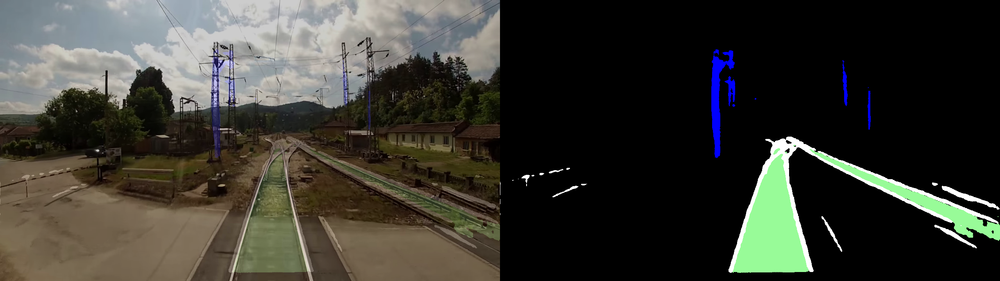

In [ ]:
mask = True # @param {type:"boolean"}
bbox_class = 'train-car' #@param ['switch-indicator', 'switch-static','track-sign-front','person-group','person', 'car', 'truck', 'train-car', 'track-signal-front', 'track-signal-back']
json_file = class2json(bbox_class)
print(json_file)

# Read Image
img = cv2.imread(os.path.join('RailSem19/rs19_jpgs',json_file+'.jpg'))
img = cv2.resize(img, (1280, 720))
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

im0s = [img]  # yolo batch expects an image inside a list
im = model.predictor.preprocess(im0s)
preds = model.predictor.model(im)
results = []
for i, pred in enumerate(preds):
    if isinstance(pred, tuple):
        pred = model.predictor.postprocess_det(pred, im, im0s)
        results.append(pred)
    else:
        if mask:
          pred = model.predictor.postprocess_seg(pred)
          results.append(pred)

if mask :
    # extract mask from preds
    mask = np.zeros(shape=(img.shape[:-1]),dtype=np.uint8)
    for i in range(len(results)-1):
      pred_mask = results[i+1].squeeze().cpu().numpy().astype(np.uint8)
      mask[pred_mask == 1] = i+1


    ## vis
    rgb_mask = np.zeros(img.shape, dtype=np.uint8)

    for value, color in color_map.items():
        rgb_mask[mask == value] = color
    blended_image = np.array(Image.blend(Image.fromarray(img), Image.fromarray(rgb_mask), alpha)) # relay mask on the original image
    results[0][0].orig_img = cv2.cvtColor(blended_image, cv2.COLOR_RGB2BGR)
    plot = results[0][0].plot()[...,::-1]
    plot = np.concatenate([plot,rgb_mask],axis=1)
else:
    plot = results[0][0].plot()
Image.fromarray(plot)

$$$$

### Predict Multiple Images

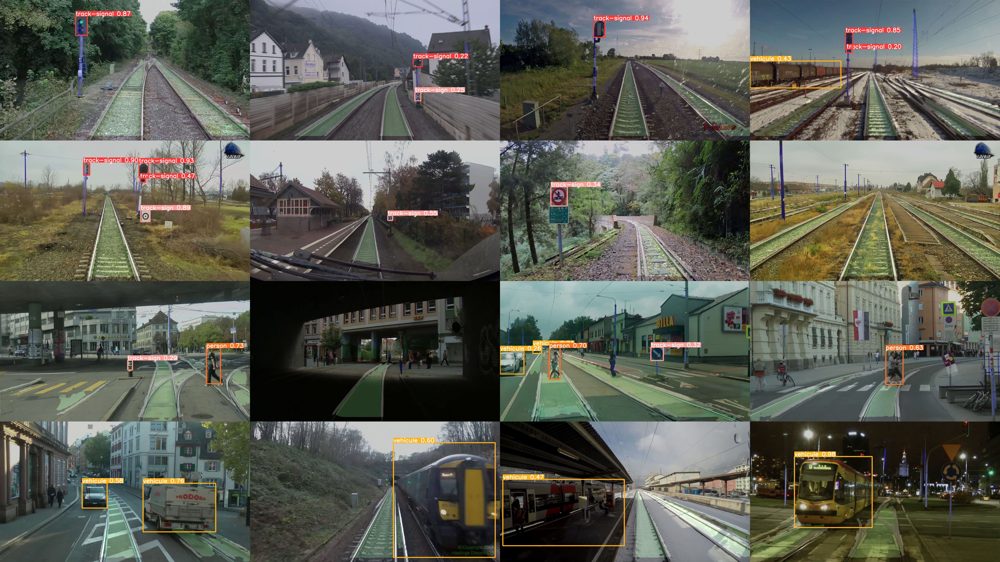

In [ ]:
paths = ['rs04180','rs00239','rs05453','rs05366', # signal
         'rs00940','rs08197','rs08187','rs00275', # sign
         'rs02605','rs01599','rs07593','rs03574', # person
         'rs00714','rs00427','rs03168','rs03255'] # Vehicule
images = []
for path in paths:
    # Read Image
    img = cv2.imread(os.path.join('RailSem19/rs19_jpgs',path+'.jpg'))
    img = cv2.resize(img, (1280, 720))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    im0s = [img]  # yolo batch expects an image inside a list
    im = model.predictor.preprocess(im0s)
    preds = model.predictor.model(im)
    results = []
    for i, pred in enumerate(preds):
        if isinstance(pred, tuple):
            pred = model.predictor.postprocess_det(pred, im, im0s)
            results.append(pred)
        else:
          pred = model.predictor.postprocess_seg(pred)
          results.append(pred)

    # extract mask from preds
    mask = np.zeros(shape=(img.shape[:-1]),dtype=np.uint8)
    for i in range(len(results)-1):
      pred_mask = results[i+1].squeeze().cpu().numpy().astype(np.uint8)
      mask[pred_mask == 1] = i+1


    ## vis
    rgb_mask = np.zeros(img.shape, dtype=np.uint8)

    for value, color in color_map.items():
        rgb_mask[mask == value] = color
    blended_image = np.array(Image.blend(Image.fromarray(img), Image.fromarray(rgb_mask), alpha)) # relay mask on the original image

    results[0][0].orig_img = cv2.cvtColor(blended_image, cv2.COLOR_RGB2BGR)
    plot = results[0][0].plot()[...,::-1]
    images.append(plot)
images = [np.concatenate([images[i],images[i+1],images[i+2],images[i+3]],axis=1) for i in range(0,16,4)]
Image.fromarray(np.concatenate(images,axis=0))